In [1]:
# Import necessary libraries
import numpy as np
import pandas as pd
import os
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import layers, models
from tensorflow.keras import optimizers
import keras
import random
from tqdm import tqdm
from google.colab import files, drive
import zipfile
import math


In [3]:
# Attach my drive to my notebook so I can access the data
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [4]:
# Determine if TPU support is available
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

Number of replicas: 1


In [5]:
# Extract data to the environment
%%time
zip_file_path = r'/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/Data.zip'
extraction_folder = '/content/'

os.makedirs(extraction_folder, exist_ok=True)

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extraction_folder)

CPU times: user 1.38 s, sys: 585 ms, total: 1.96 s
Wall time: 7.75 s


In [6]:
'''
Steps:
1) Apply transforms of data
2) Initialize data with Dataset and DataLoader Classes
3) Create model
4) Train Model with typical training loop
5) Evaluate Model
'''

'\nSteps:\n1) Apply transforms of data\n2) Initialize data with Dataset and DataLoader Classes\n3) Create model\n4) Train Model with typical training loop\n5) Evaluate Model\n'

# Problem Topic/Description
The aim of this project is to create a generative deep learning model that can successfully produce semi-realistic faux Calude Monet paintings. Specifically, a Generative Adversarial Network (GAN) is created to produce these faux paintings. A GAN is a combination of two neural networks that are called generator and discriminator. The generator is the neural network that produces the faux paintings. Before training, the GAN is only able to produce a noise output. The GAN is trained using feedback from the discriminator, whose job is to be able to recognize the difference between a faux painting and a real Monet painting. These two networks are oppossed to each other - the generator tries to trick the discriminator into thinking its generated images are real and the discriminator works to ensure it can tell the difference between the real and fake images.

For this project, the task is to build a GAN that generates 7,500 Monet-style images.

In [7]:
# Display the number of tfrec files in the appropriate directories
monet_tfrec_path = '/content/Data/monet_tfrec'
photo_tfrec_path = '/content/Data/photo_tfrec'

monet_filenames = tf.io.gfile.glob(monet_tfrec_path + '/*.tfrec')
photo_filenames = tf.io.gfile.glob(photo_tfrec_path + '/*.tfrec')

print(f'Number of Monet TFRecord Files: {len(monet_filenames)}')
print(f'Number of Monet Photo Files: {len(photo_filenames)}')

Number of Monet TFRecord Files: 5
Number of Monet Photo Files: 20


In [ ]:
# Determine what metadata is contained in the TFRecords
monet_datasets = [tf.data.TFRecordDataset(file) for file in monet_filenames]
photo_datasets = [tf.data.TFRecordDataset(file) for file in photo_filenames]

# Parse the protocol buffers in the TFRecords
def parse_tfrecord_fn(example):
    example_proto = tf.train.Example()
    example_proto.ParseFromString(example.numpy())
    return example_proto

print(parse_tfrecord_fn(iter(monet_datasets[0]).next()))
print(parse_tfrecord_fn(iter(photo_datasets[0]).next()))

In [9]:
# After determining the metadata in the TFRecord above, parse the data and determine it's size and how many samples are in the dataset
feature_description = {
    'image': tf.io.FixedLenFeature([], tf.string),
    'image_name': tf.io.FixedLenFeature([], tf.string),
    'target': tf.io.FixedLenFeature([], tf.string)
}

# Parse protocol buffer in TFRecords
def parse_function(proto):
    return tf.io.parse_single_example(proto, feature_description)

# Determine the dimensions of the data
dim = None
dim_list = []
for dataset in monet_datasets:
    for record in dataset.map(parse_function):
        image = tf.io.decode_jpeg(record['image'].numpy())
        current_dim = image.shape
        if dim is None:
            dim_list.append(current_dim)
            dim = current_dim
        if dim is not None and current_dim != dim:
            dim = current_dim
            dim_list.append(current_dim)

# Ensure that all dimensions in the monet data are the same size
if len(dim_list) == 1:
    print(f'Monet painting dimensions are: {dim_list[0].as_list()}')

# Determine the dimensions of the photo data
dim = None
dim_list = []
for dataset in photo_datasets:
    for record in dataset.map(parse_function):
        image = tf.io.decode_jpeg(record['image'].numpy())
        current_dim = image.shape
        if dim is None:
            dim_list.append(current_dim)
            dim = current_dim
        if dim is not None and current_dim != dim:
            dim = current_dim
            dim_list.append(current_dim)

# Ensure that all dimensions in the photo data are the same size
if len(dim_list) == 1:
    print(f'Photo dimensions are: {dim_list[0].as_list()}')

# Determine the number of samples in the data
count_monet = 0
for dataset in monet_datasets:
    count_monet += sum(1 for _ in dataset)
print(f'Number of samples in Monet data: {count_monet}')

count_photo = 0
for dataset in photo_datasets:
    count_photo += sum(1 for _ in dataset)
print(f'Number of samples in photo data: {count_photo}')

Monet painting dimensions are: [256, 256, 3]
Photo dimensions are: [256, 256, 3]
Number of samples in Monet data: 300
Number of samples in photo data: 7038


# Data Description

After briefly inspecting the data that will be used to generate the Monet-style paintings, there came several important findings. First, all of the data has the same dimensions which are 256 x 256 pixel images with 3 channels, indicating that each image has color. In the Monet dataset, there are only 300 unique images which is small batch of data to train a neural network, nonetheless, the network should still be capable of producing some meaningful results. The photo data is more hefty. It contains 7038 distinct images which could be useful for training. In order to work with the data more efficiently, the TFRecord files were parsed to attain the working data.

# Exploratory Data Analysis (EDA)

For the EDA, a sample of images from the Monet dataset and photo dataset are displayed. The images in both datasets are highly detailed and since the size of the images are so large ([256,256,3] to be exact), it will take many epochs for the generator to start producing realistic paintings.

Monet painting samples


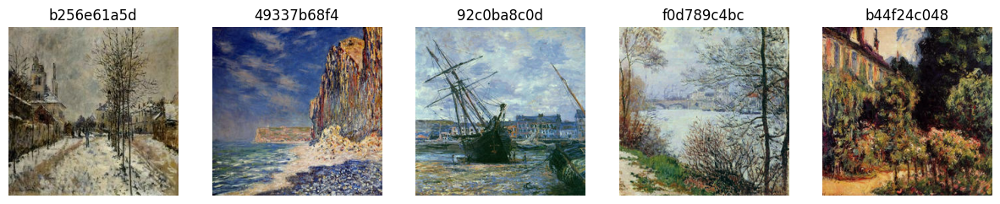

Photo samples


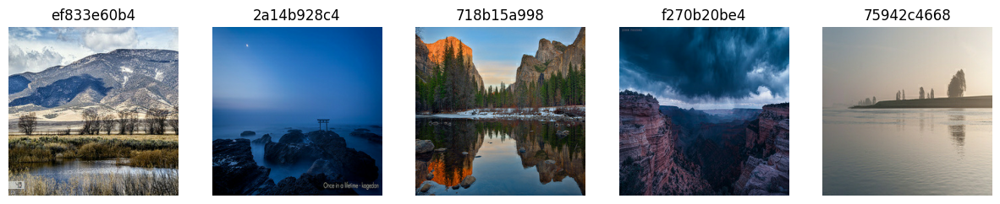

In [10]:
# Let's display some of the samples
def display_samples(dataset, num_images=5):
    plt.figure(figsize=(15,5))
    for i, record in enumerate(dataset.map(parse_function)):
        if i >= num_images:
            break
        # Decode image
        image = tf.io.decode_jpeg(record['image'].numpy())
        # Plot image
        plt.subplot(1, num_images, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(record['image_name'].numpy().decode('utf-8'))
    plt.show()

# Display images from Monet dataset
print('Monet painting samples')
display_samples(monet_datasets[0])
# Display images from Photo dataset
print('Photo samples')
display_samples(photo_datasets[0])

# Model Architecture
In the project description on Kaggle, it mentioned taking a look at a cycle GAN notebook for a tutorial on how to build a GAN for this project. Nonetheless, I will build a Deep Convolutional GAN (DCGAN) for this task that will generate Monet-style images from the Monet images themselves. The cycle GAN is used to take the photos in the photo dataset and apply Monet-style to the photo, that is, a picture of a real river would be transformed to a painting that has Monet-style. The architecture I built will produce new images solely based on the Monet paintings, rather than transferring his style to a real photograph.

The architecture of the GAN follows that of the architecture described in the original DCGAN paper. I developed two models. The first model is simplier and more shallow than the second network. For the first model, the generator was developed starting from random noise and generating a 32x32 dimension image. The image was then upsampled utilizing Conv2DTranspose layers until I reached the targeted 256x256 image dimension. The discriminator utilizes 3 Conv2D layers to downsample the image, prior to making a fully connected layer that links to 1 neuron to predict a probability of whether the image is real or fake.

In the second model, I created a deeper architecture. The input was converted to an 4x4 image with 512 channels. The 4x4 image was then scaled using Convolutional Transpose layers until an output of 256x256x3 image was acheived. The generator utilized ReLU activation functions everywhere except the output layer, which uses a Tanh activation function, as advised by the original GAN paper.

The discriminator utilizes 6 Convolutional layers to scale the original 256x256x3 image down and then transformed the last layer's output into 1 dimension to inform the last neuron to make a prediciton between 0 and 1 of the images' authenticity. These layer's utilized a Leaky ReLU activation function everywhere except the output, which uses a sigmoid activaiton funciton, as advised by the original GAN paper. 30% weight dropouts were also utilized in the discriminator to prevent it from learning too quickly and overpowering the generator.

The input to both generators was a random noise vector with 128 values defining the latent space. Batch normalization was utilized in most layers in both the generator and discriminator. Strides of 2 were used to upsample and downsample the images.

In addition, for the discriminator loss funciton, label smoothing was utilized to prevent the discriminator from being overly confident of its predictions. This helps the generator learn and converge more efficiently.

In [11]:
# Function to plot an image or a batch of images
def plt_image(img, reconstruct=False, batch=False, rows=2, cols=5):
    if batch:
      if reconstruct:
        img = [0.5 * image + 0.5 for image in img]
      fig, axes = plt.subplots(rows, cols, figsize = (15,5))
      fig.tight_layout(pad=0.5)

      for i, ax in enumerate(axes.flat):
        if i < len(img):
          ax.imshow(img[i])
          ax.axis('off')
        else:
          ax.axis('off')
      plt.show()
    else:
      if reconstruct:
        img = 0.5 * img + 0.5
      plt.figure(figsize=(15,5))
      img.shape
      plt.imshow(img)
      plt.axis('off')
      plt.show()

In [21]:
# Define Model Paths
generator_1_path = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/Models/generator_1'
generator_2_path = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/Models/generator_2'
discriminator_1_path = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/Models/discriminator_1'
discriminator_2_path = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/Models/discriminator_2'

# Define a function to save a model
def save_model(generator, discriminator, model_path_gen, model_path_disc):
  # Save as a SavedModel
  generator.save(model_path_gen + '.keras')
  discriminator.save(model_path_disc + '.keras')

# Define a function to load a model
def load_model(model_path):
  return tf.keras.models.load_model(model_path)

In [22]:
# Define a function to create monet-style paintings
save_path_1 = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/GeneratedImages1'
save_path_2 = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/GeneratedImages2'

def GenerateImages(generator, path):
  noise = np.random.normal(0, 1, size=[7500, latent_dim])
  batch_size = 50

  for i in range(0, len(noise), batch_size):
      batch_noise = noise[i:i + batch_size]
      batch_images = generator.predict(batch_noise)
      batch_images = 0.5 * batch_images + 0.5  # Convert to proper pixel values

      # Save each batch as a .npy file
      np.save(f"{path}/generated_batch_{i // batch_size}.npy", batch_images)

In [14]:
# Create a function to save the loss values
save_path_loss = '/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/LossValues'
def SaveLosses(g_loss, d_loss, model_num):
  g_loss = np.array(g_loss)
  d_loss = np.array(d_loss)
  np.save(f'{save_path_loss}/g_loss_{model_num}.npy', g_loss)
  np.save(f'{save_path_loss}/d_loss_{model_num}.npy', d_loss)

In [15]:
# Define Hyperparameters
num_epochs = 20
batch_size = 30
buffer_size = 300
batch_count = math.ceil(count_monet/batch_size)
learning_rate_dis = 0.00025
learning_rate_gen = 0.00025
beta_1 = 0.5
latent_dim = 128

# Step 1: Apply transforms to the data
def load_and_preprocess_image(record):
    image = tf.io.decode_jpeg(record['image'])
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = (image-0.5)/0.5 # Normalize image data
    return image

# Step 2: Initialize dataset
images = [load_and_preprocess_image(record) for dataset in monet_datasets for record in dataset.map(parse_function)]
image_dataset = tf.data.Dataset.from_tensor_slices(images).shuffle(buffer_size).batch(batch_size)

# Ensure data shape is correct
sample_images = next(iter(image_dataset))
sample_images.shape

TensorShape([30, 256, 256, 3])

In [16]:
# Create loss functions for the models
loss_fn = keras.losses.BinaryCrossentropy()

def discriminator_loss(real_output_eval, fake_output_eval):
    # Add random noise to make discriminator less confident of it's predictions
    y_dis_real = tf.ones_like(real_output_eval)
    y_dis_real -= 0.1 * tf.random.uniform(shape=y_dis_real.shape) # Make discriminator less confident that an image is real
    y_dis_fake = tf.zeros_like(fake_output_eval)
    y_dis_fake += 0.1 * tf.random.uniform(shape=y_dis_fake.shape) # Make discriminator less confident that an image is fake

    # Calculate losses
    real_loss = loss_fn(y_dis_real, real_output_eval)
    fake_loss = loss_fn(y_dis_fake, fake_output_eval)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(dis_fake_output_eval):
    return loss_fn(tf.ones_like(dis_fake_output_eval), dis_fake_output_eval)

In [17]:
# Step 3: Create Model
def build_generator():
    model = models.Sequential(
        [
            layers.Input(shape=(latent_dim,)),
            layers.Dense(256*32*32),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Reshape((32, 32, 256)),
            layers.Conv2DTranspose(256, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(128, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(32, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2D(3, kernel_size=7, activation='tanh', padding='same'),
        ],
        name='generator',
    )
    return model

def build_discriminator():
    model = models.Sequential(
        [
            layers.Input(shape=(256,256,3)),
            layers.Conv2D(128, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Conv2D(256, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Conv2D(512, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Flatten(),
            layers.Dense(1, activation='sigmoid'),
        ],
        name='discriminator',
    )
    return model

# Create generator and discriminator and summarize the networks
generator_1 = build_generator()
generator_1.summary()
discriminator_1 = build_discriminator()
discriminator_1.summary()

# Define optimizers and base loss function
d_optimizer_1 = optimizers.Adam(learning_rate=learning_rate_dis, beta_1=beta_1)
g_optimizer_1 = optimizers.Adam(learning_rate=learning_rate_gen, beta_1=beta_1)

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 262144)              │      33,816,576 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 262144)              │       1,048,576 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 262144)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 32, 32, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 64, 64, 256)         │       1,638,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 64, 64, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 64, 64, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 128, 128, 128)       │         819,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 128, 128, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 256, 256, 32)        │         102,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 256, 256, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 256, 256, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 256, 256, 3)         │           4,707 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 37,431,939 (142.79 MB)

 Trainable params: 36,906,819 (140.79 MB)

 Non-trainable params: 525,120 (2.00 MB)

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 128, 128, 128)       │           9,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 128, 128, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 64, 64, 256)         │         819,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 64, 64, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 64, 64, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64, 64, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 32, 32, 512)         │       3,277,312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 32, 32, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 32, 32, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 32, 32, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 524288)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │         524,289 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,634,369 (17.68 MB)

 Trainable params: 4,632,577 (17.67 MB)

 Non-trainable params: 1,792 (7.00 KB)

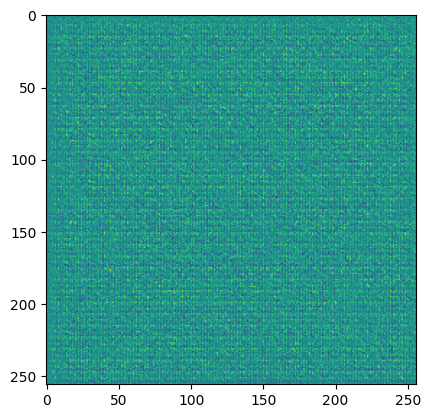

In [18]:
# Display a sample image from the untrained generator
noise = tf.random.normal([1, 128])
generated_image = generator_1(noise, training=False)

plt.imshow(generated_image[0, :, :, 0])

In [19]:
# Step 4: Train Model
def get_real_images(batch_size):
    random.shuffle(images)
    return random.sample(images, batch_size)
def training_loop(generator, discriminator, d_optimizer, g_optimizer):
    g_loss_ls = []
    d_loss_ls = []
    for epoch in tqdm(range(num_epochs)):
        for batch_num, real_images in enumerate(image_dataset):
            # Create data to train the discriminator
            noise = tf.random.normal([batch_size, latent_dim])

            # Create generated images and evaluate with discriminator
            # Calculate gradients and optimize the weights of the networks
            with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
                generated_images = generator(noise, training=True)
                real_output_eval = discriminator(real_images, training=True)
                fake_output_eval = discriminator(generated_images, training=True)

                g_loss = generator_loss(fake_output_eval)
                d_loss = discriminator_loss(real_output_eval, fake_output_eval)

            g_grads = g_tape.gradient(g_loss, generator.trainable_variables)
            d_grads = d_tape.gradient(d_loss, discriminator.trainable_variables)
            g_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))
            d_optimizer.apply_gradients(zip(d_grads, discriminator.trainable_variables))

        # Display information at certain frequencies
        if epoch % 2 == 0:
            print(f'In epoch [{epoch+1}/{num_epochs}] and batch [{batch_num+1}/{batch_count}] the losses are: \ng_loss {g_loss} and d_loss {d_loss}')
            g_loss_ls.append(g_loss)
            d_loss_ls.append(d_loss)
            plt_image(generated_images[:10], reconstruct=True, batch=True)
    return g_loss_ls, d_loss_ls

  0%|          | 0/20 [00:00<?, ?it/s]

In epoch [1/20] and batch [10/10] the losses are: 
g_loss 12.141552925109863 and d_loss 2.373514175415039


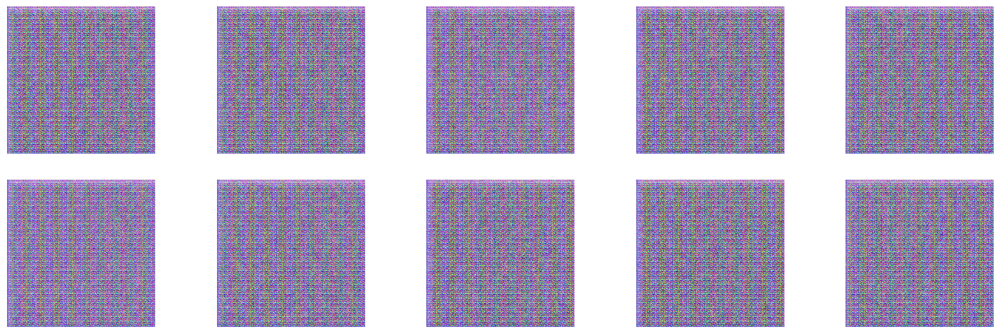

 10%|█         | 2/20 [01:05<09:26, 31.46s/it]

In epoch [3/20] and batch [10/10] the losses are: 
g_loss 0.00033018598333001137 and d_loss 10.427177429199219


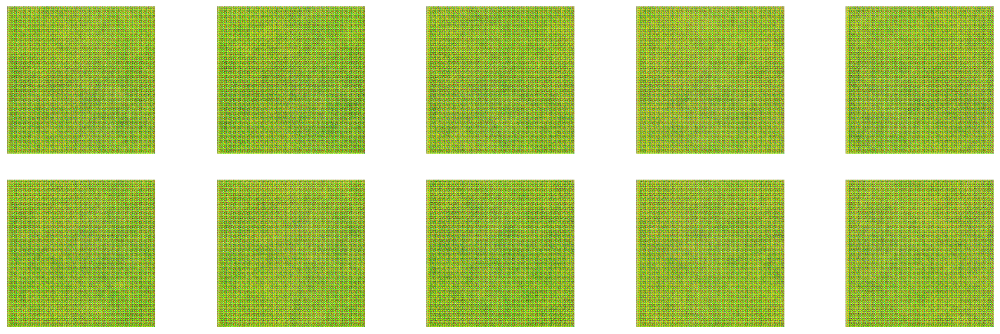

 20%|██        | 4/20 [02:12<08:59, 33.70s/it]

In epoch [5/20] and batch [10/10] the losses are: 
g_loss 19.377119064331055 and d_loss 1.4445339441299438


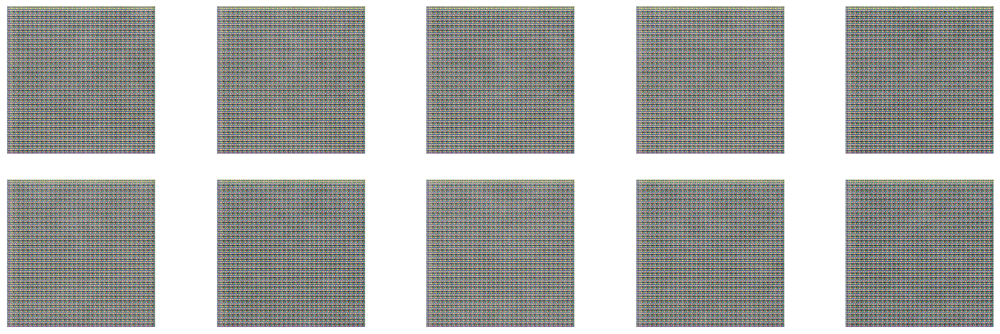

 30%|███       | 6/20 [03:03<06:46, 29.03s/it]

In epoch [7/20] and batch [10/10] the losses are: 
g_loss 20.947607040405273 and d_loss 3.891615629196167


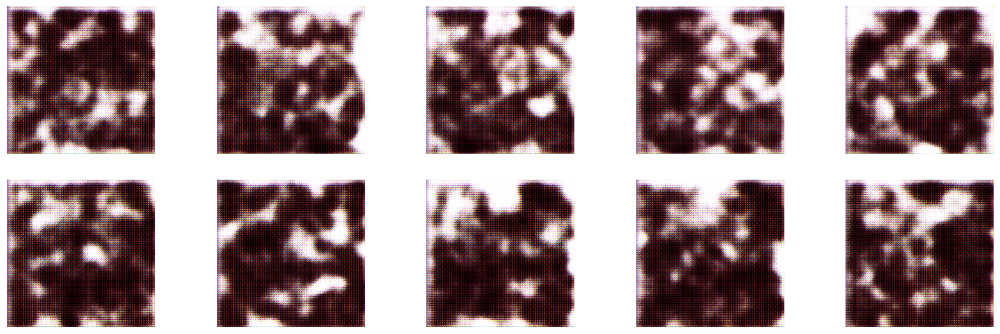

 40%|████      | 8/20 [04:10<06:07, 30.61s/it]

In epoch [9/20] and batch [10/10] the losses are: 
g_loss 15.749127388000488 and d_loss 7.63292121887207


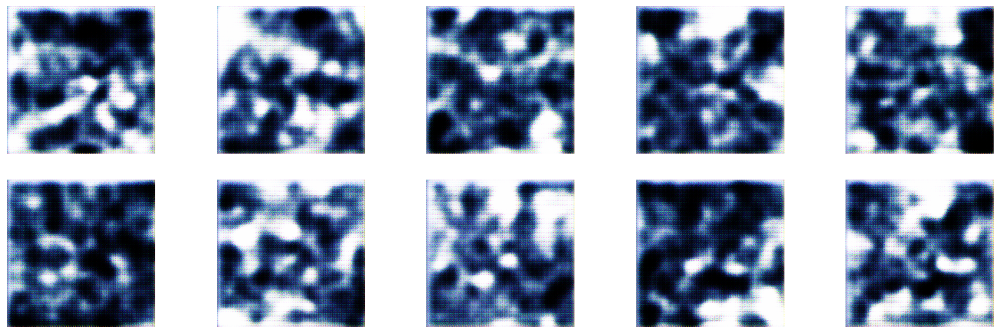

 50%|█████     | 10/20 [05:33<06:02, 36.29s/it]

In epoch [11/20] and batch [10/10] the losses are: 
g_loss 19.71546173095703 and d_loss 6.922529220581055


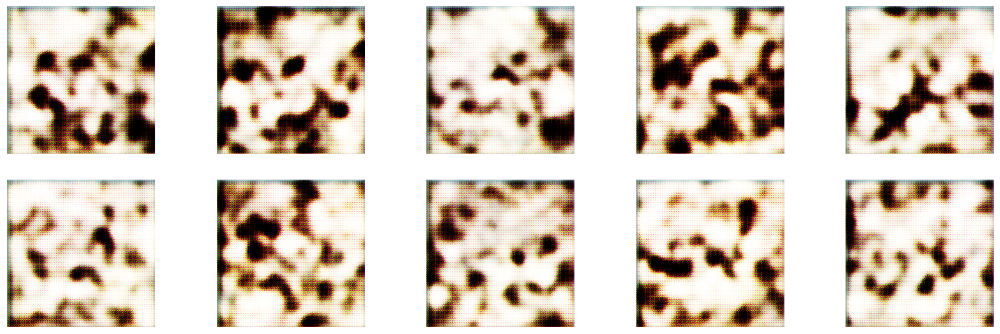

 60%|██████    | 12/20 [06:25<04:06, 30.77s/it]

In epoch [13/20] and batch [10/10] the losses are: 
g_loss 4.16721248626709 and d_loss 1.0883183479309082


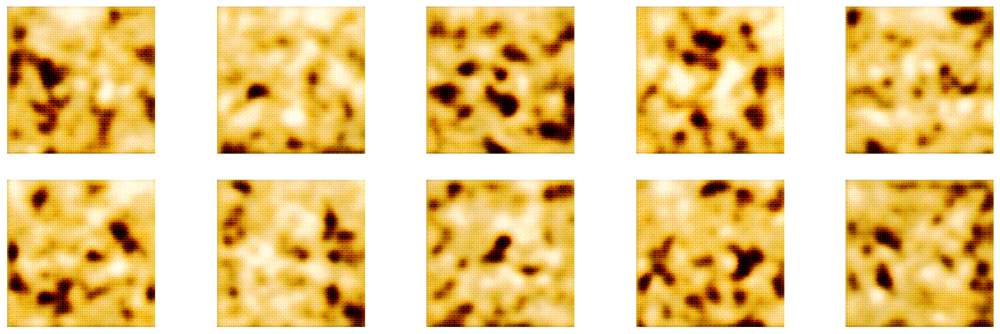

 70%|███████   | 14/20 [07:16<02:48, 28.01s/it]

In epoch [15/20] and batch [10/10] the losses are: 
g_loss 2.801962375640869 and d_loss 1.857118844985962


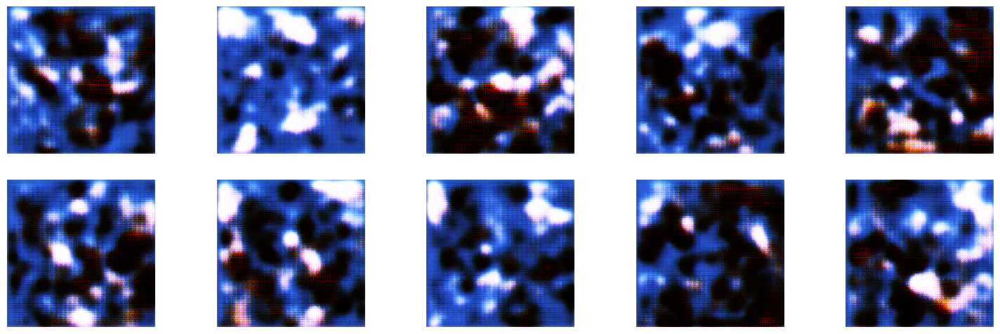

 80%|████████  | 16/20 [08:23<02:06, 31.54s/it]

In epoch [17/20] and batch [10/10] the losses are: 
g_loss 6.32295036315918 and d_loss 4.277035236358643


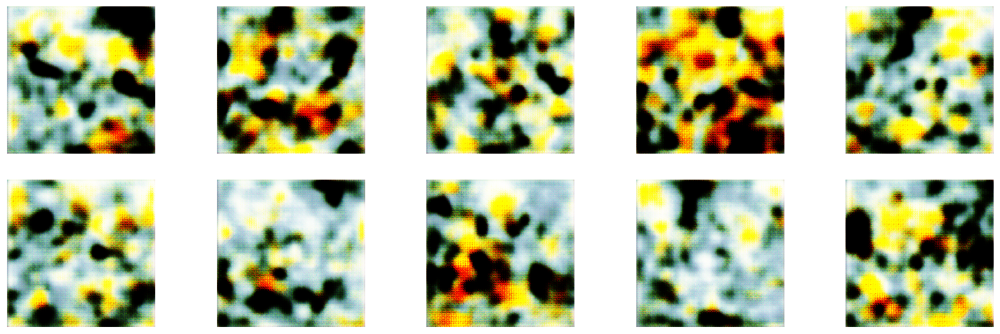

 90%|█████████ | 18/20 [09:15<00:57, 28.63s/it]

In epoch [19/20] and batch [10/10] the losses are: 
g_loss 1.6123828887939453 and d_loss 2.5629446506500244


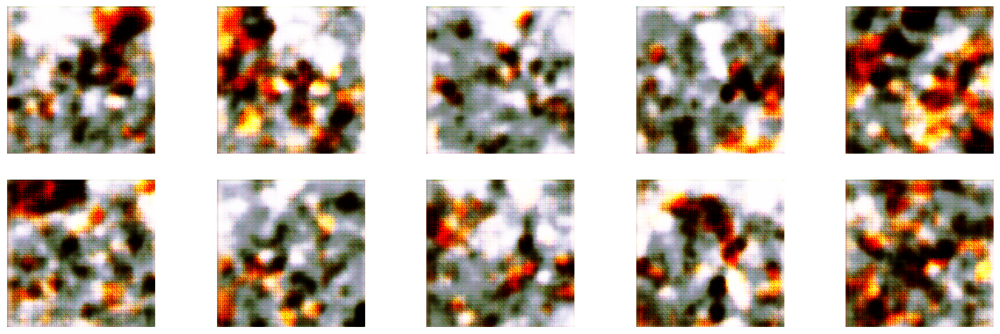

100%|██████████| 20/20 [10:38<00:00, 31.90s/it]


ValueError: The `save_format` argument is deprecated in Keras 3. Please remove this argument and pass a file path with either `.keras` or `.h5` extension.Received: save_format=tf

In [20]:
# Run training loop
dcgan_1_g_loss, dcgan_1_d_loss = training_loop(generator_1, discriminator_1, d_optimizer_1, g_optimizer_1)

In [ ]:
# Save model
save_model(generator_1, discriminator_1, generator_1_path, discriminator_1_path)
# Save loss values
SaveLosses(dcgan_1_g_loss, dcgan_1_d_loss, 1)
# Generate Monet style images from generator 1
GenerateImages(generator_1, save_path_1)

In [24]:
# Step 3: Create Model
def build_generator():
    model = models.Sequential(
        [
            layers.Input(shape=(latent_dim,)),
            layers.Dense(512*4*4),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Reshape((4, 4, 512)),
            layers.Conv2DTranspose(512, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(256, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(128, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(32, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2DTranspose(16, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.ReLU(),
            layers.Conv2D(3, kernel_size=7, activation='tanh', padding='same'),
        ],
        name='generator',
    )
    return model

def build_discriminator():
    model = models.Sequential(
        [
            layers.Input(shape=(256,256,3)),
            layers.Conv2D(16, kernel_size=5, strides=2, padding='same'),
            layers.LeakyReLU(negative_slope=0.2),
            layers.Conv2D(32, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(negative_slope=0.2),
            layers.Conv2D(64, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(negative_slope=0.2),
            layers.Conv2D(128, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Conv2D(256, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Conv2D(512, kernel_size=5, strides=2, padding='same'),
            layers.BatchNormalization(),
            layers.LeakyReLU(0.2),
            layers.Dropout(0.3),
            layers.Flatten(),
            layers.Dense(1, activation='sigmoid'),
        ],
        name='discriminator',
    )
    return model

# Create generator and discriminator and summarize the networks
generator_2 = build_generator()
generator_2.summary()
discriminator_2 = build_discriminator()
discriminator_2.summary()

# Define optimizers and base loss function
d_optimizer_2 = optimizers.Adam(learning_rate=learning_rate_dis, beta_1=beta_1)
g_optimizer_2 = optimizers.Adam(learning_rate=learning_rate_gen, beta_1=beta_1)

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                      │ (None, 8192)                │       1,056,768 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 8192)                │          32,768 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_4 (ReLU)                       │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 4, 4, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 8, 8, 512)           │       6,554,112 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_8                │ (None, 8, 8, 512)           │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_5 (ReLU)                       │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 16, 16, 256)         │       3,277,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_9                │ (None, 16, 16, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_6 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_5 (Conv2DTranspose) │ (None, 32, 32, 128)         │         819,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_10               │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_7 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_6 (Conv2DTranspose) │ (None, 64, 64, 64)          │         204,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_11               │ (None, 64, 64, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_8 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_7 (Conv2DTranspose) │ (None, 128, 128, 32)        │          51,232 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 128, 128, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 12,015,331 (45.83 MB)

 Trainable params: 11,996,931 (45.76 MB)

 Non-trainable params: 18,400 (71.88 KB)

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 128, 128, 16)        │           1,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 128, 128, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 64, 64, 32)          │          12,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_14               │ (None, 64, 64, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 64, 64, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 32, 32, 64)          │          51,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_15               │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_5 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 16, 16, 128)         │         204,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_16               │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_6 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 8, 8, 256)           │         819,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_17               │ (None, 8, 8, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_7 (LeakyReLU)            │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 4, 4, 512)           │       3,277,312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_18               │ (None, 4, 4, 512)           │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_8 (LeakyReLU)            │ (None, 4, 4, 512)           │              

 Total params: 4,379,169 (16.71 MB)

 Trainable params: 4,377,185 (16.70 MB)

 Non-trainable params: 1,984 (7.75 KB)

In [ ]:
# Run training loop
dcgan_2_g_loss, dcgan_2_d_loss = training_loop(generator_2, discriminator_2, d_optimizer_2, g_optimizer_2)

In [ ]:
# Save model
save_model(generator_2, discriminator_2, generator_2_path, discriminator_2_path)
# Save loss values
SaveLosses(dcgan_2_g_loss, dcgan_2_d_loss, 2)
# Generate Monet style images from generator 2
GenerateImages(generator_2, save_path_2)

In [ ]:
# Step 5: Evaluate Model
'''
This is done metrically via Kaggle's MiFID implementation. Nonetheless, we will visually inspect the data below.
'''

NameError: name 'np' is not defined

# Results and Analysis

The results indicate that many more epochs are needed in order to produce paintings more similar to Monet's authentic paintings. Below I display some samples of the two architecture's generator's outputs. The images are not very diversified nor realistic. This is due to the low epoch count. I do not have GPU support on my local machine, so I paid for the Google Collab GPU usuage, however, after many epochs, the runtime would also disconnect and forget my model. Waiting for days to train the model to produce realistic results is impracticable.

Nonetheless, the 20 epoch threshold proved that the model was making progress and that more epochs would help. The training was very stable as displayed in the loss chart for the two architectures - the generator and discriminator kept battling against one another to produce better results as indicated in the sinusoidic behavior of the plot

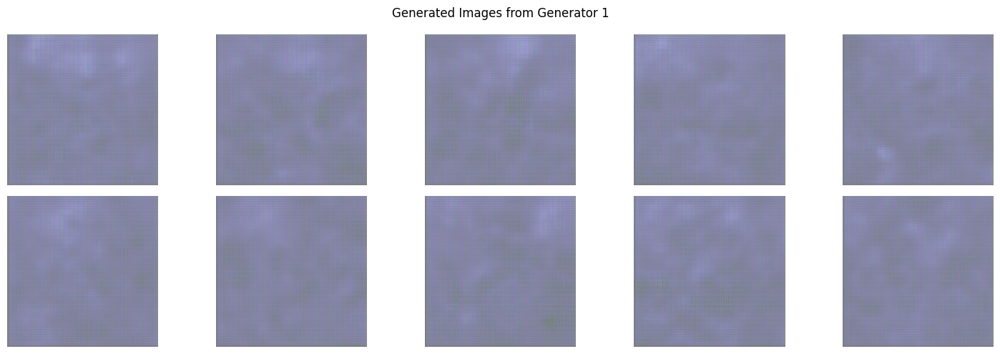

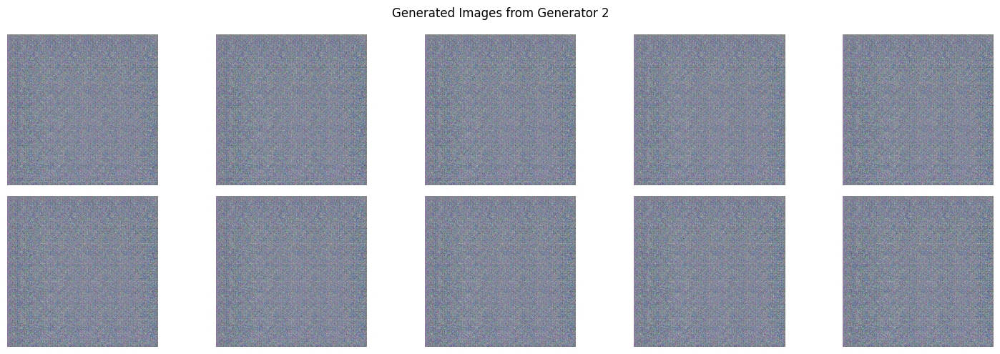

In [28]:
generated_images_1 = np.load('/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/GeneratedImages1/generated_batch_0.npy')
generated_images_2 = np.load('/content/drive/MyDrive/Colab Notebooks/ML3 Week 5 Programming Assignment/GeneratedImages2/generated_batch_0.npy')

# Display sample of final images
def DisplaySamples(generated_images, model_num):
    fig = plt.figure(figsize=(15,5))
    for i, img in enumerate(generated_images[:10]):
        plt.subplot(2, 5, i+1)
        plt.imshow(img)
        plt.axis('off')
        fig.suptitle(f'Generated Images from Generator {model_num}')

    plt.tight_layout()
    plt.show()

DisplaySamples(generated_images_1[:10], 1)
DisplaySamples(generated_images_2[:10], 2)

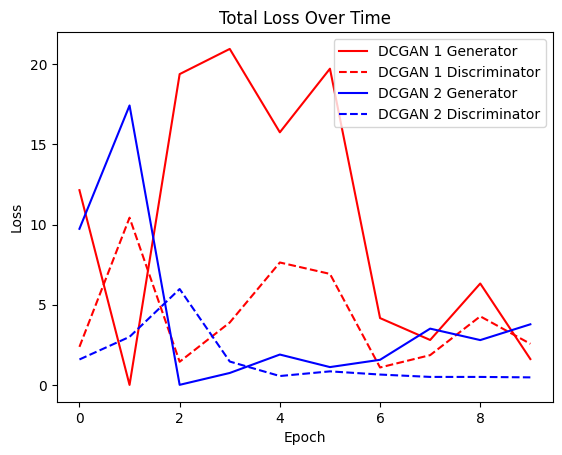

In [29]:
# Show how total losses changed over time during training
plt.plot(dcgan_1_g_loss, color='red', label='DCGAN 1 Generator')
plt.plot(dcgan_1_d_loss, color='red', linestyle='--', label='DCGAN 1 Discriminator')
plt.plot(dcgan_2_g_loss, color='blue', label='DCGAN 2 Generator')
plt.plot(dcgan_2_d_loss, color='blue', linestyle='--', label='DCGAN 2 Discriminator')

plt.title('Total Loss Over Time')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Conclusion
In conclusion, the two architectures were performing well during training. This was expected due to following the convential architecture of the original GAN paper. While the images did not yet produce realistic results, this would be remedied by training the models over many more epochs. If given a stable training envrionment (i.e. a local machine with GPU support), the project would have produced much more interesting and realistic results.